In [1]:
import os

save_path = '/Users/jaeseok/Downloads/hw4_ai4c/kaggle_bee_vs_wasp'
images_dir = '/Users/jaeseok/Downloads/hw4_ai4c/kaggle_bee_vs_wasp/bee_temp'
output_file = os.path.join(save_path, 'cropped_bees.json') 
import megadetector

In [2]:


!python -m megadetector.detection.run_detector_batch "MDV5A" "$images_dir" "$output_file" --recursive --output_relative_filenames --quiet


Model MDV5A available at /var/folders/p3/0zlpsjwn5qg2cs76gk4zyryr0000gn/T/megadetector_models/md_v5a.0.0.pt
112 image files found in the input directory
PyTorch reports 0 available CUDA devices
PyTorch reports Metal Performance Shaders are available
GPU available: True
Imported YOLOv5 as utils.*
Using PyTorch version 2.5.1
Fusing layers... 
Fusing layers... 
Model summary: 733 layers, 140054656 parameters, 0 gradients, 208.8 GFLOPs
Model summary: 733 layers, 140054656 parameters, 0 gradients, 208.8 GFLOPs
Sending model to GPU
Loaded model in 4.6 seconds
Loaded model in 4.6 seconds
100%|█████████████████████████████████████████| 112/112 [00:28<00:00,  3.88it/s]
Finished inference for 112 images in 36.08 seconds (3.10 images per second)
Output file saved at /Users/jaeseok/Downloads/hw4_ai4c/kaggle_bee_vs_wasp/cropped_bees.json
Done, thanks for MegaDetect'ing!


Displaying bee with confidence 0.301


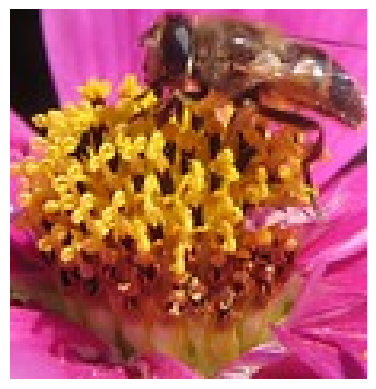

Displaying bee with confidence 0.567


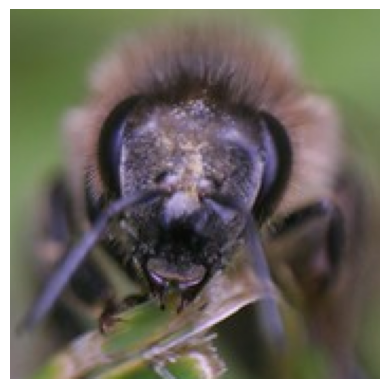

Displaying bee with confidence 0.448


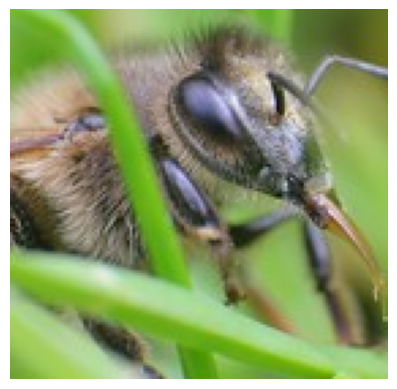

Displaying bee with confidence 0.387


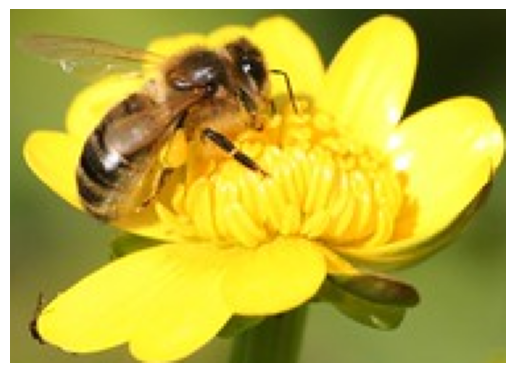

Displaying bee with confidence 0.415


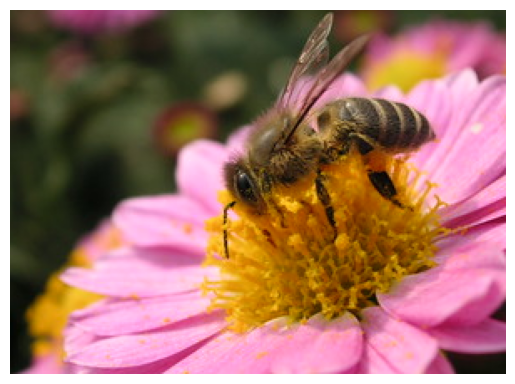

Displaying bee with confidence 0.42


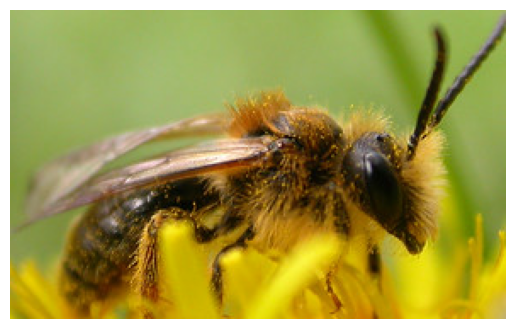

Displaying bee with confidence 0.509


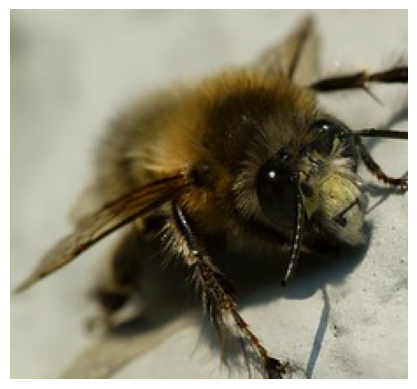

Displaying bee with confidence 0.663


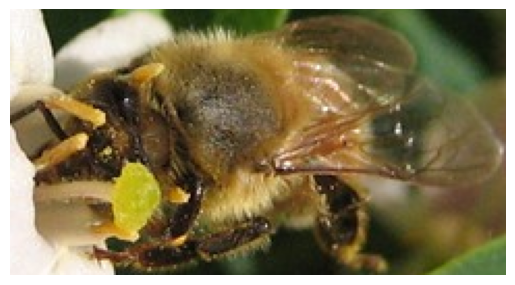

Displaying bee with confidence 0.353


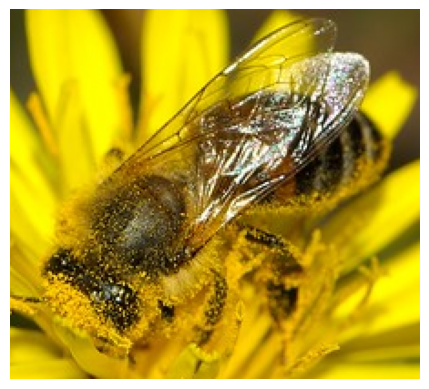

Displaying bee with confidence 0.862


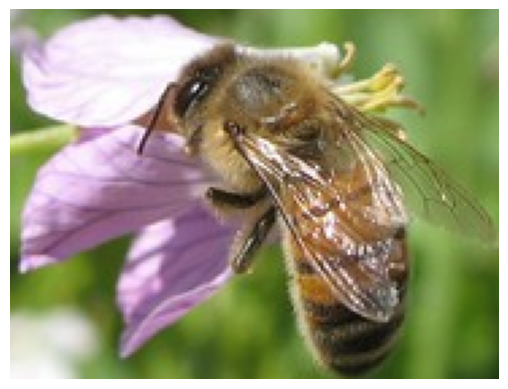

Displaying bee with confidence 0.364


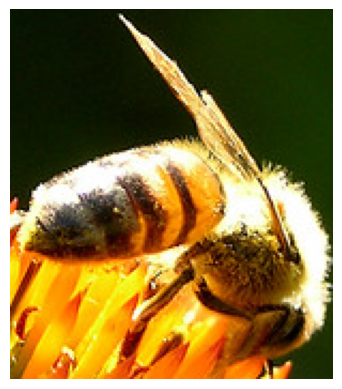

Displaying bee with confidence 0.661


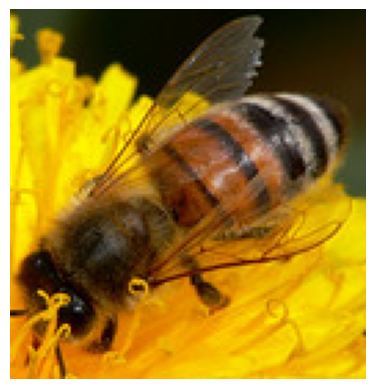

Displaying bee with confidence 0.485


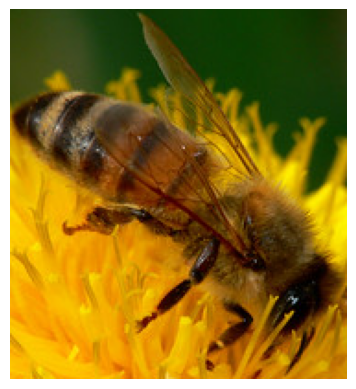

Displaying bee with confidence 0.598


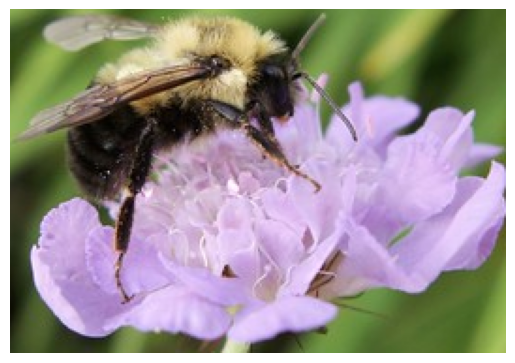

Displaying bee with confidence 0.834


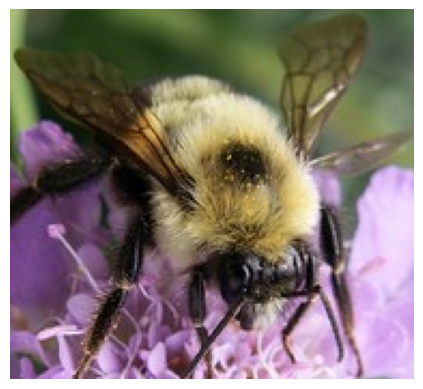

Displaying bee with confidence 0.795


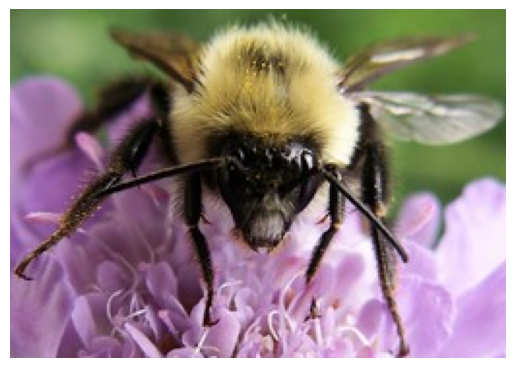

Displaying bee with confidence 0.527


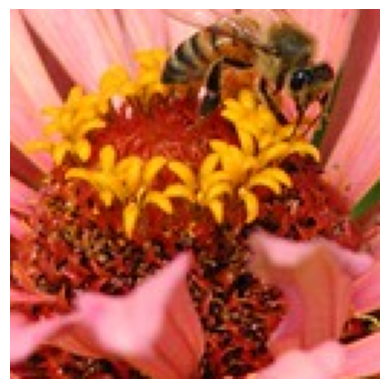

Displaying bee with confidence 0.533


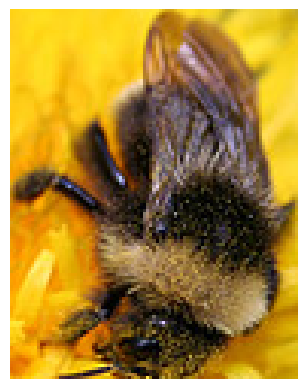

Displaying bee with confidence 0.35


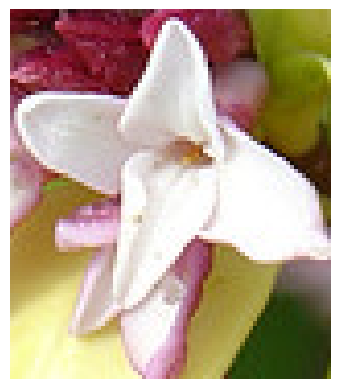

Displaying bee with confidence 0.728


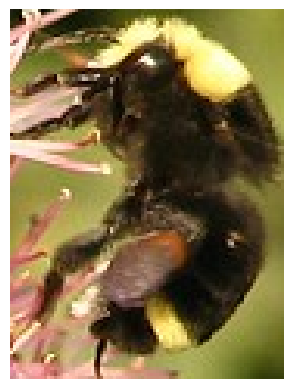

Displaying bee with confidence 0.714


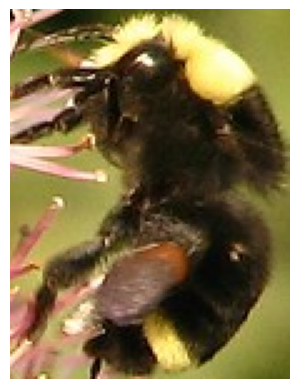

Displaying bee with confidence 0.696


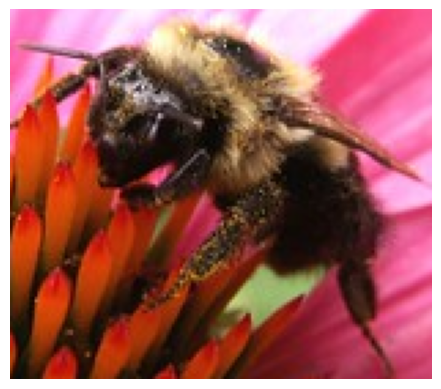

Displaying bee with confidence 0.63


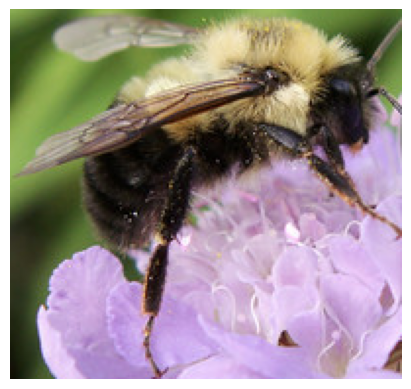

Displaying bee with confidence 0.652


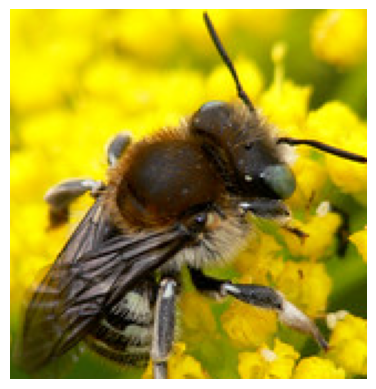

Displaying bee with confidence 0.664


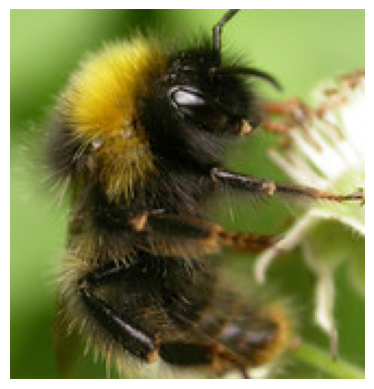

Displaying bee with confidence 0.729


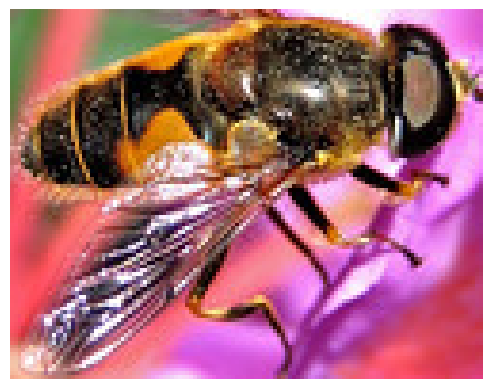

Displaying bee with confidence 0.61


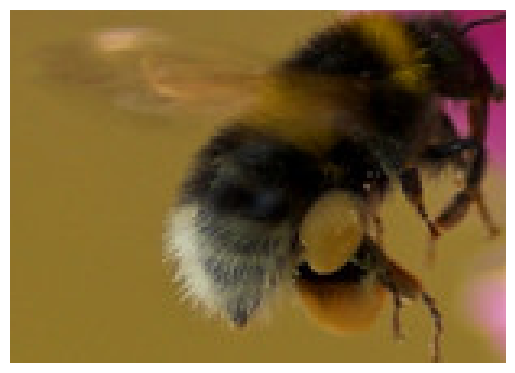

Displaying bee with confidence 0.531


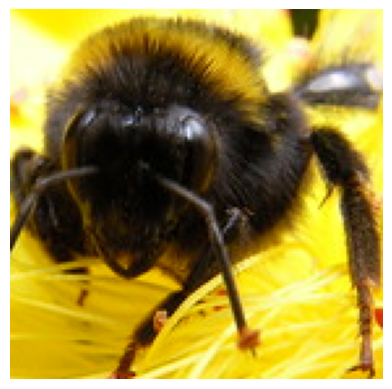

Displaying bee with confidence 0.69


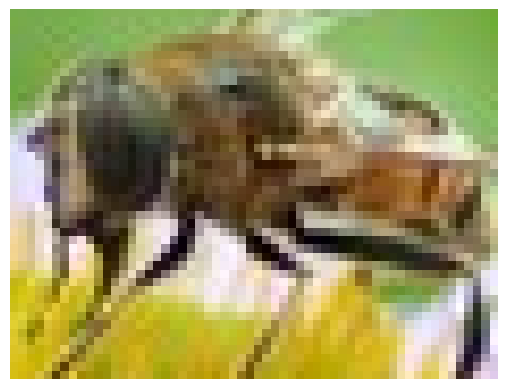

Displaying bee with confidence 0.471


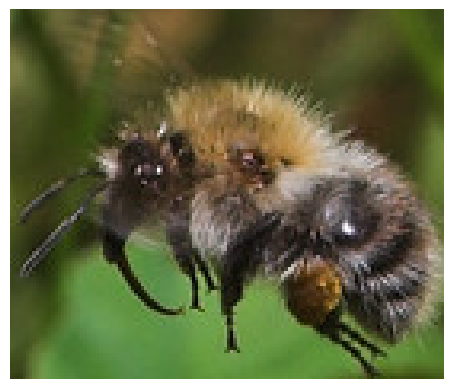

Displaying bee with confidence 0.73


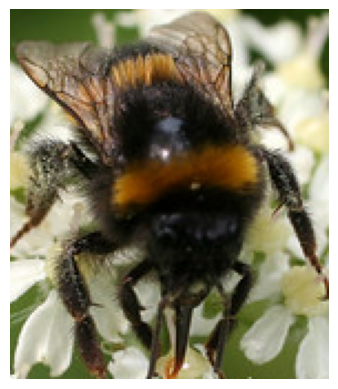

Displaying bee with confidence 0.366


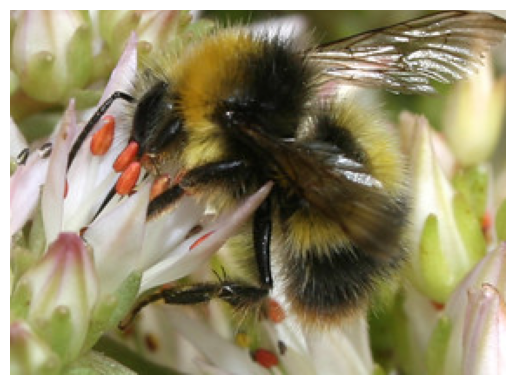

Displaying bee with confidence 0.474


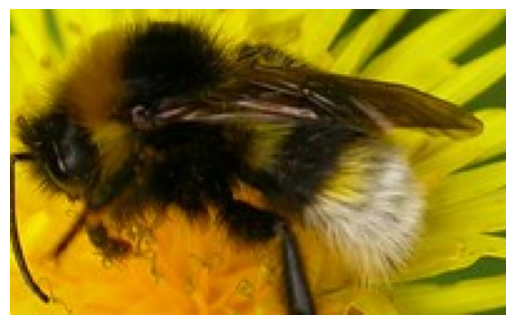

Displaying bee with confidence 0.653


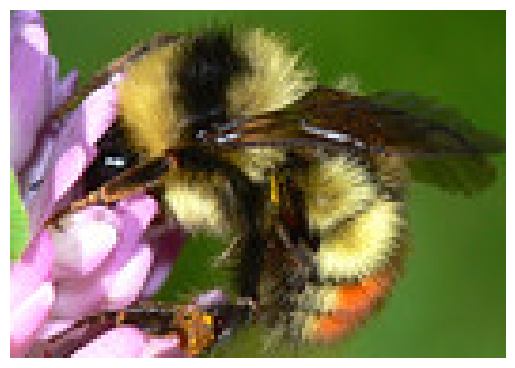

Displaying bee with confidence 0.549


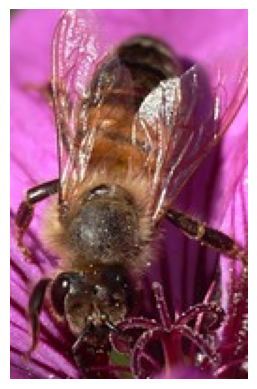

Displaying bee with confidence 0.421


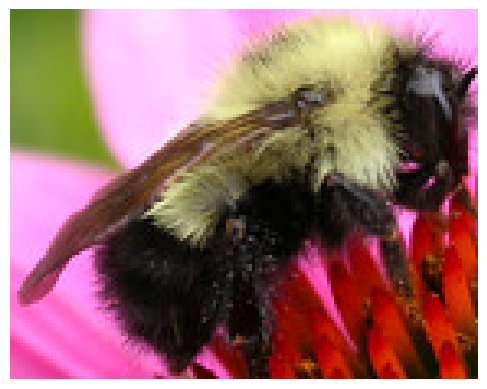

Displaying bee with confidence 0.548


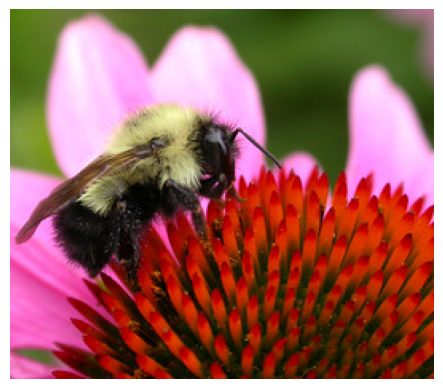

Displaying bee with confidence 0.736


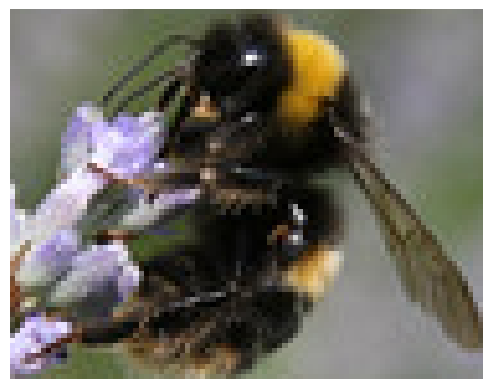

Displaying bee with confidence 0.314


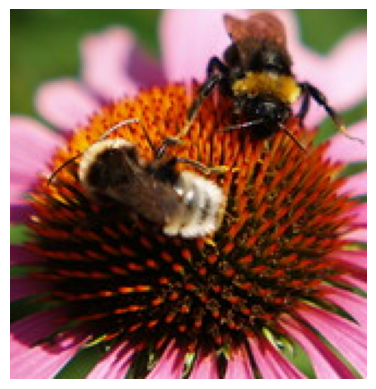

Displaying bee with confidence 0.806


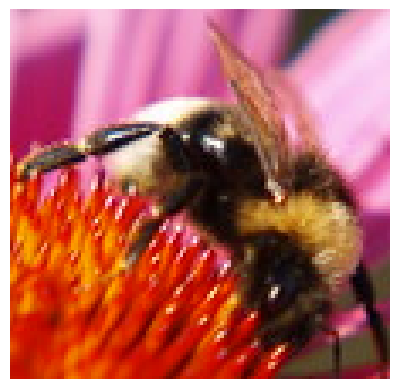

Displaying bee with confidence 0.821


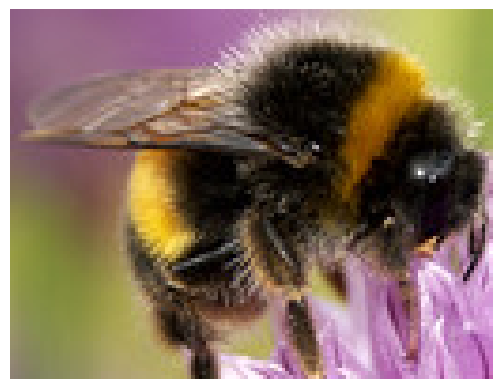

Displaying bee with confidence 0.495


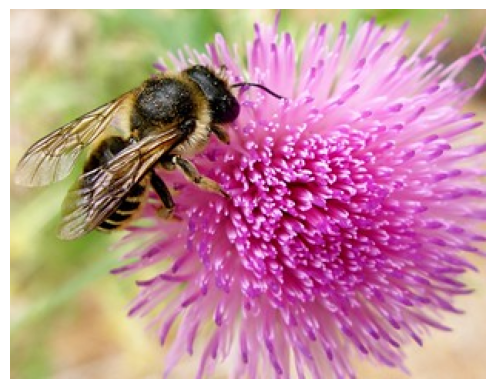

Displaying bee with confidence 0.756


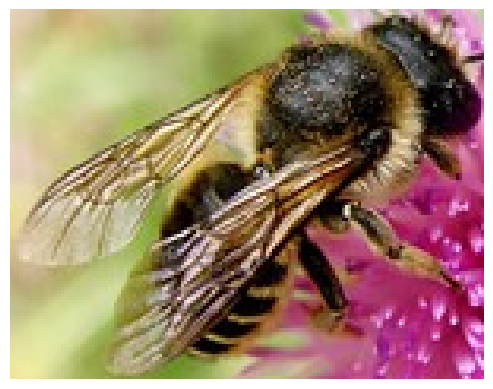

Displaying bee with confidence 0.779


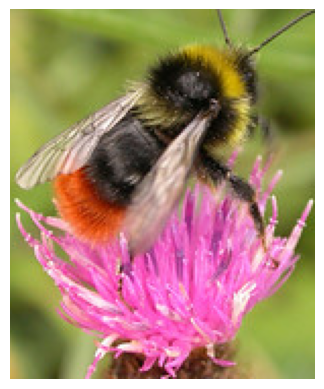

Displaying bee with confidence 0.396


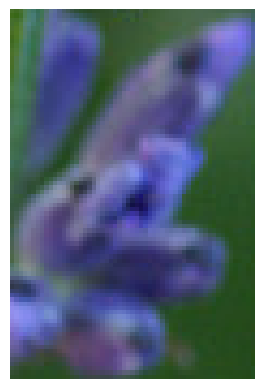

Displaying bee with confidence 0.669


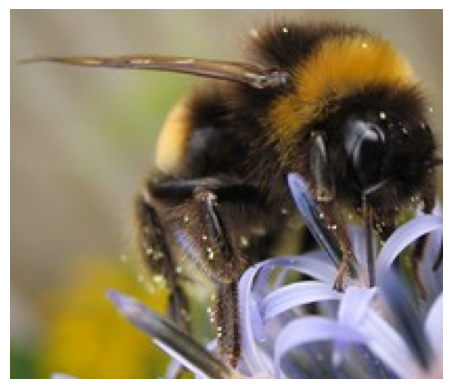

Displaying bee with confidence 0.328


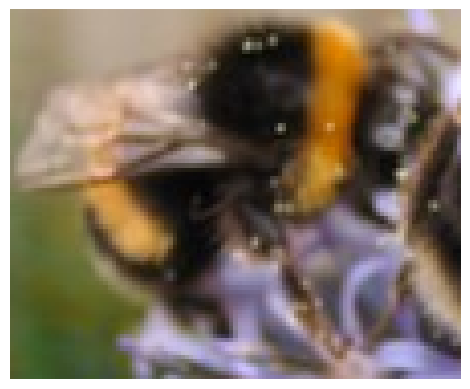

Displaying bee with confidence 0.708


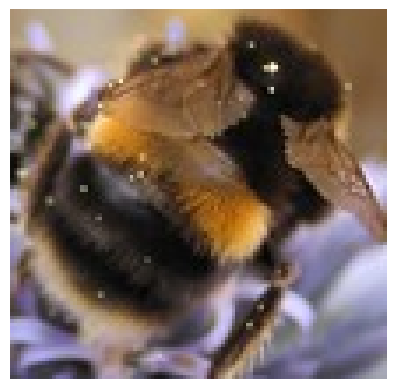

Displaying bee with confidence 0.353


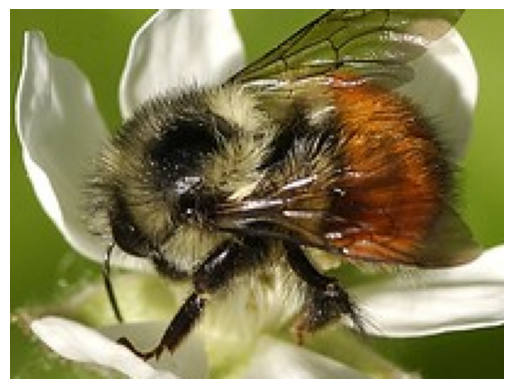

Displaying bee with confidence 0.721


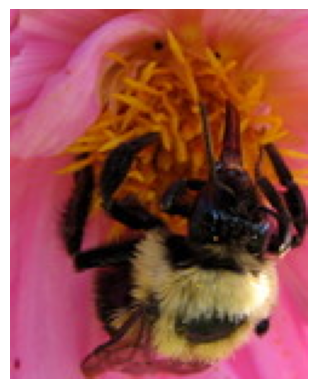

Displaying bee with confidence 0.374


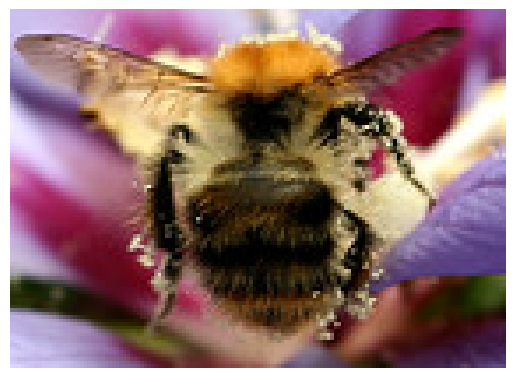

Displaying bee with confidence 0.504


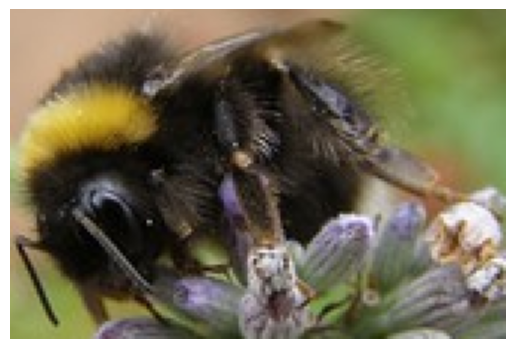

Displaying bee with confidence 0.582


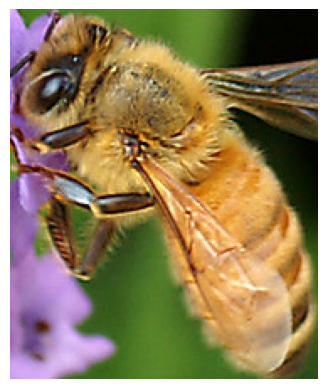

Displaying bee with confidence 0.606


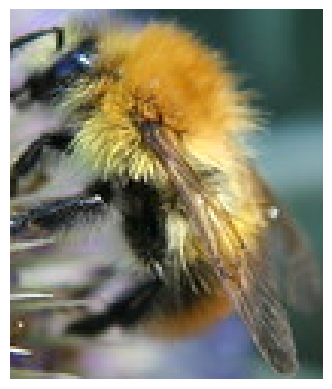

Displaying bee with confidence 0.655


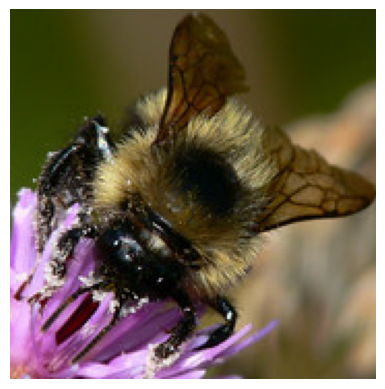

Displaying bee with confidence 0.495


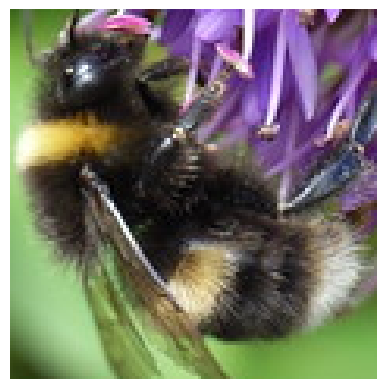

Displaying bee with confidence 0.474


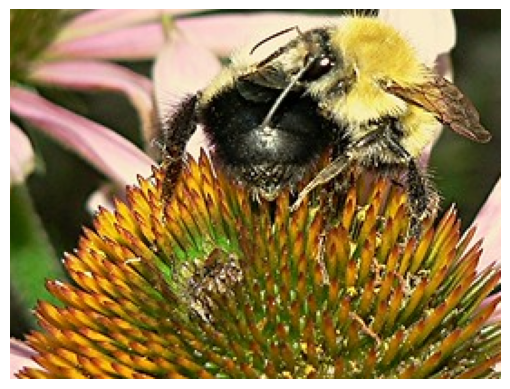

Displaying bee with confidence 0.332


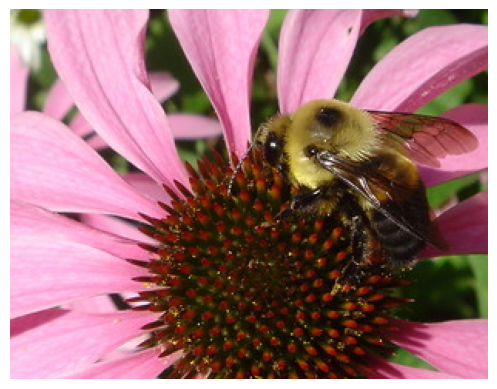

Displaying bee with confidence 0.528


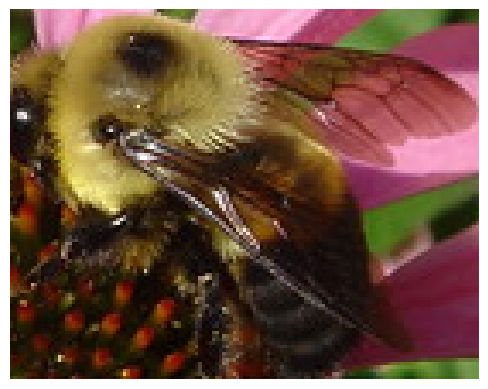

Displaying bee with confidence 0.388


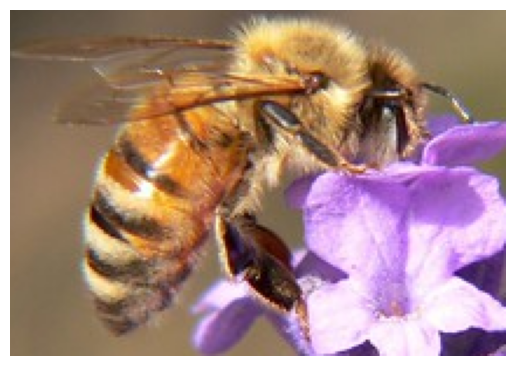

Displaying bee with confidence 0.413


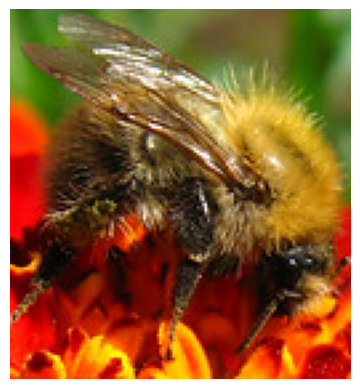

Displaying bee with confidence 0.555


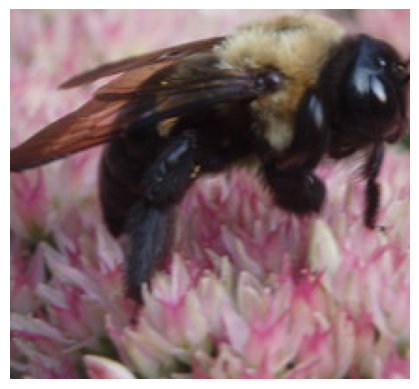

Displaying bee with confidence 0.554


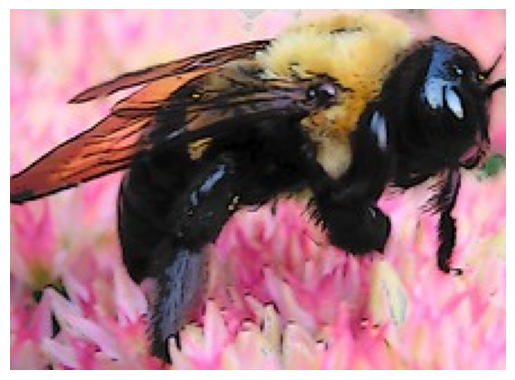

Displaying bee with confidence 0.442


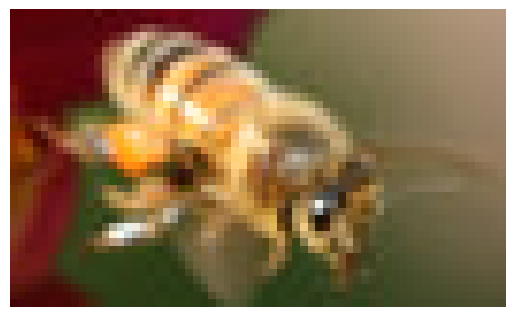

Displaying bee with confidence 0.625


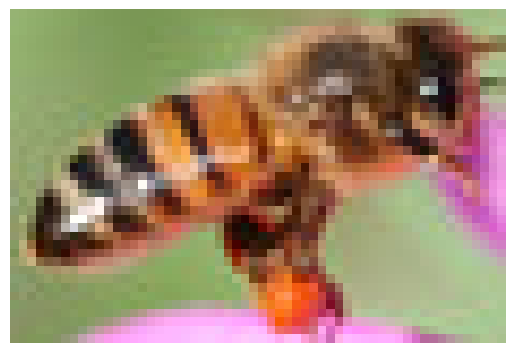

Displaying bee with confidence 0.741


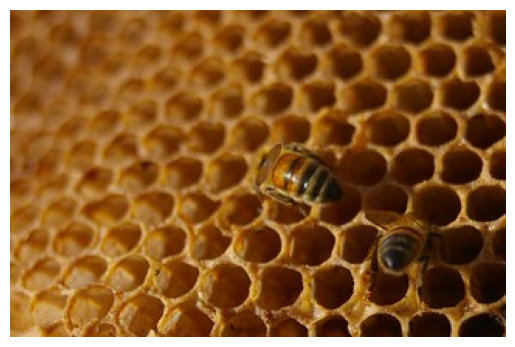

Displaying bee with confidence 0.519


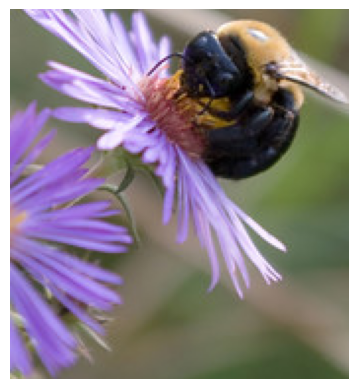

Displaying bee with confidence 0.426


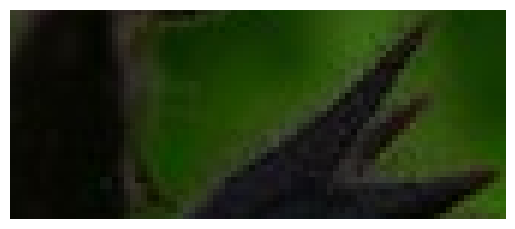

Displaying bee with confidence 0.488


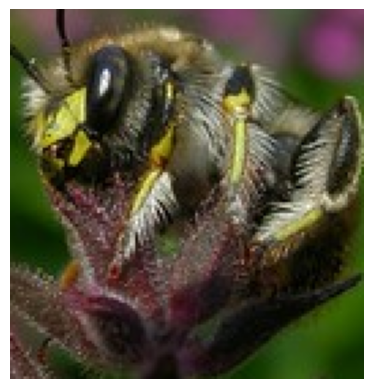

Displaying bee with confidence 0.464


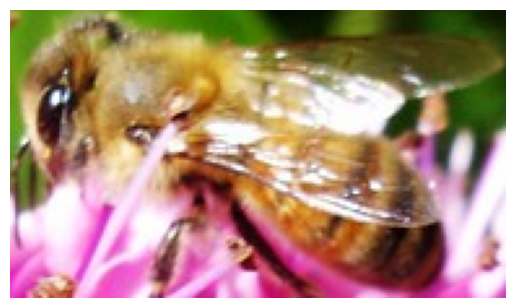

Displaying bee with confidence 0.515


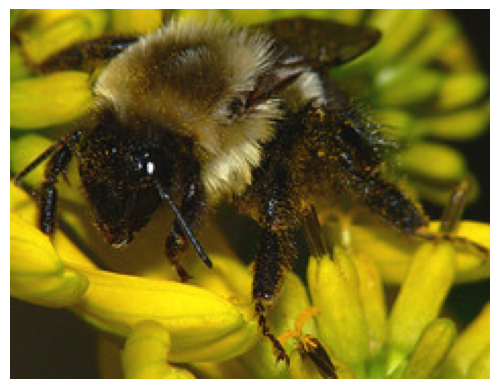

Displaying bee with confidence 0.366


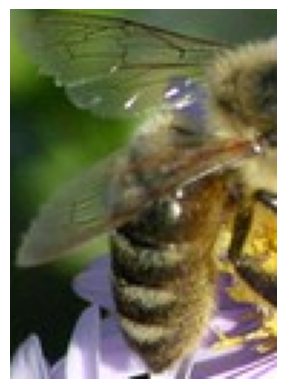

Displaying bee with confidence 0.552


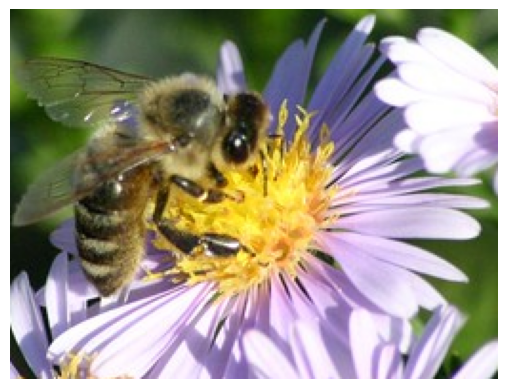

Displaying bee with confidence 0.465


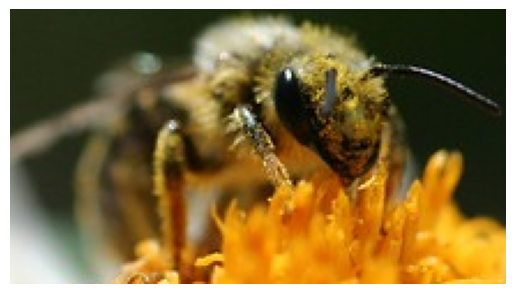

Displaying bee with confidence 0.709


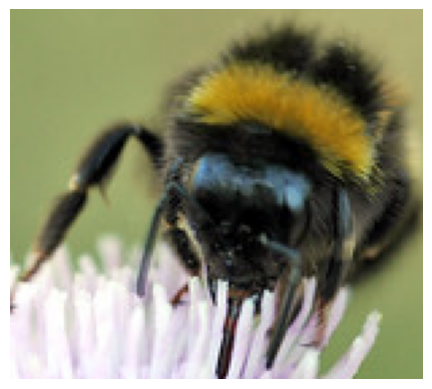

Displaying bee with confidence 0.324


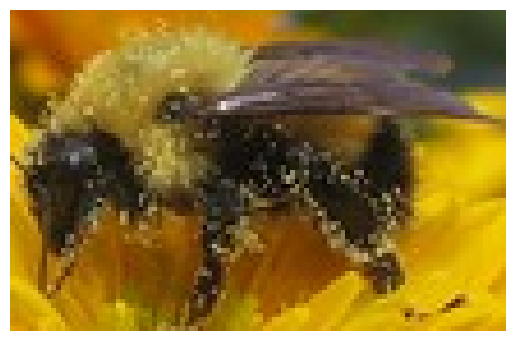

Displaying bee with confidence 0.517


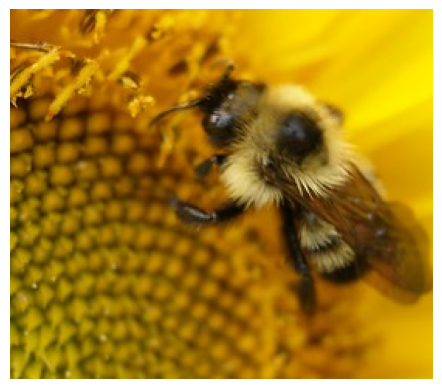

Displaying bee with confidence 0.333


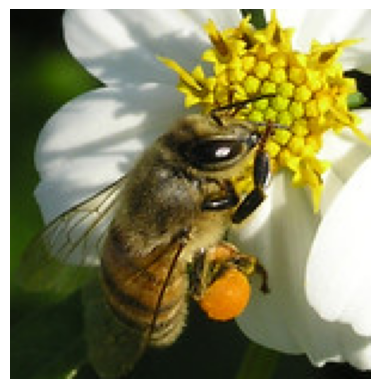

Displaying bee with confidence 0.726


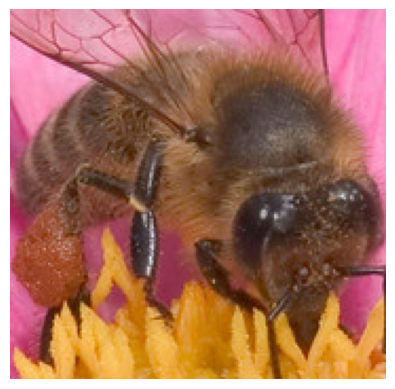

Displaying bee with confidence 0.735


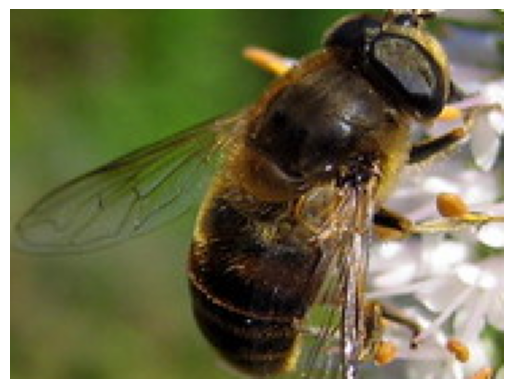

Displaying bee with confidence 0.432


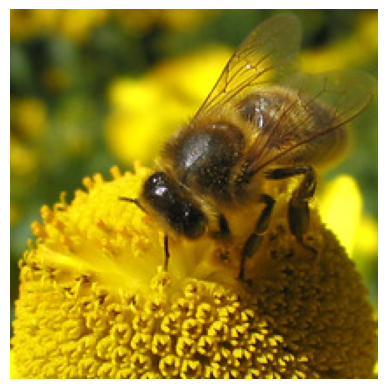

Displaying bee with confidence 0.577


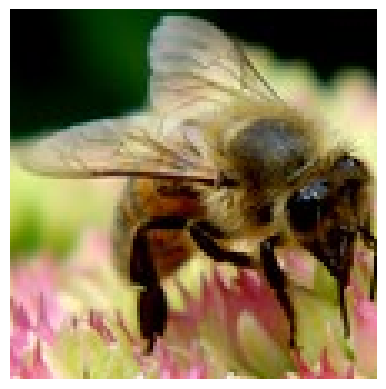

Displaying bee with confidence 0.415


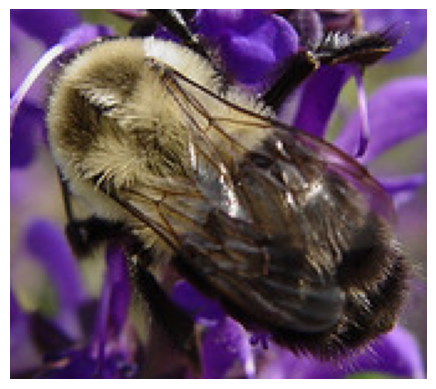

Displaying bee with confidence 0.771


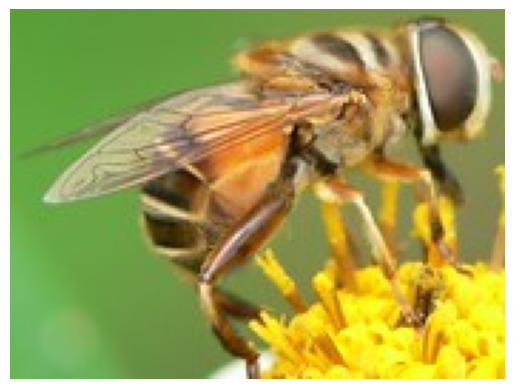

Displaying bee with confidence 0.782


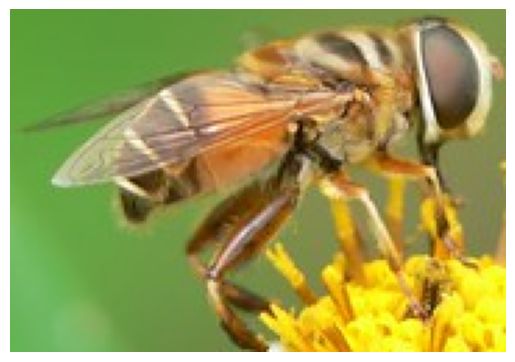

Displaying bee with confidence 0.449


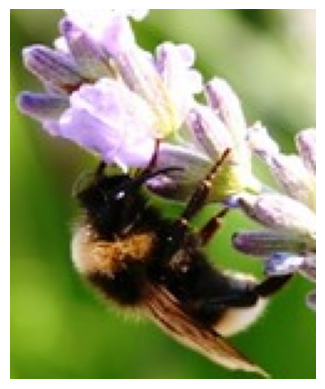

Displaying bee with confidence 0.921


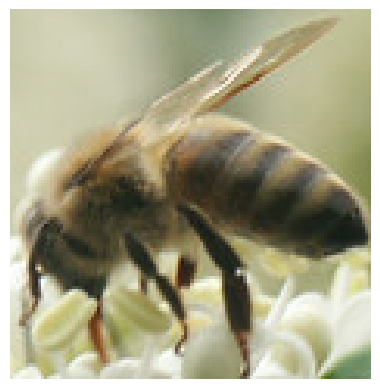

Displaying bee with confidence 0.906


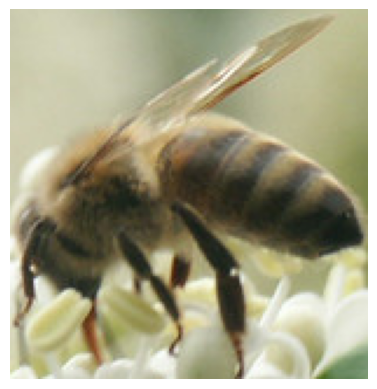

Displaying bee with confidence 0.452


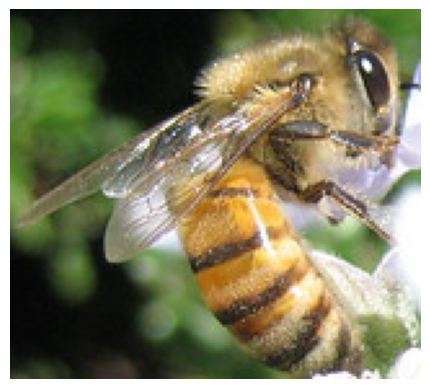

In [4]:
import json
import cv2
import os
from matplotlib import pyplot as plt


images_dir = '/Users/jaeseok/Downloads/hw4_ai4c/kaggle_bee_vs_wasp/bee_temp'
json_file = '/Users/jaeseok/Downloads/hw4_ai4c/kaggle_bee_vs_wasp/cropped_bees.json'

with open(json_file, 'r') as file:
    data = json.load(file)

bee_category = "1"  
confidence_threshold = 0.3 

def display_bbox(image, bbox):
    height, width = image.shape[:2]
    x, y, w, h = bbox
    
    x1 = int(x * width)
    y1 = int(y * height)
    x2 = int((x + w) * width)
    y2 = int((y + h) * height)
    
    cropped_img = image[y1:y2, x1:x2]
    plt.imshow(cv2.cvtColor(cropped_img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

# Process each image and display bee detections only
for item in data['images']:
    image_path = os.path.join(images_dir, item['file'])
    
    if os.path.isfile(image_path):
        # Load image
        image = cv2.imread(image_path)
        
        for detection in item['detections']:
            category = detection['category']
            confidence = detection['conf']
            bbox = detection['bbox']
            
            # Only display if the detection is a bee and meets confidence threshold
            if category == bee_category and confidence >= confidence_threshold:
                print(f"Displaying bee with confidence {confidence}")
                display_bbox(image, bbox)
    else:
        print(f"Image file {item['file']} not found in {images_dir}")



0: 480x640 (no detections), 82.1ms
Speed: 1.7ms preprocess, 82.1ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)

0: 640x480 (no detections), 71.1ms
Speed: 1.2ms preprocess, 71.1ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 480)

0: 576x640 1 bird, 80.0ms
Speed: 1.4ms preprocess, 80.0ms inference, 0.1ms postprocess per image at shape (1, 3, 576, 640)
Displaying bee with confidence 0.4993301033973694


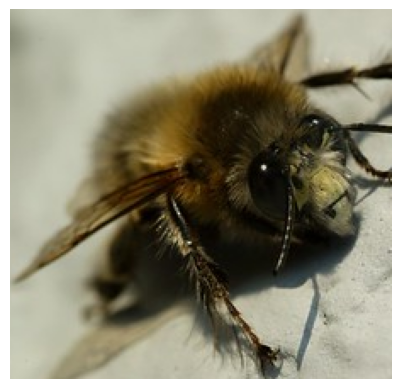


0: 576x640 1 bird, 87.2ms
Speed: 1.9ms preprocess, 87.2ms inference, 0.1ms postprocess per image at shape (1, 3, 576, 640)
Displaying bee with confidence 0.4871743321418762


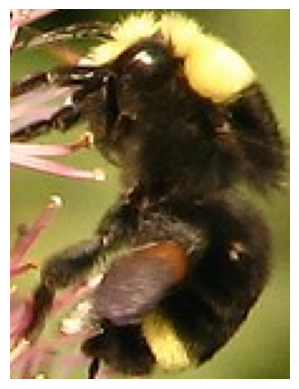


0: 480x640 1 cat, 72.6ms
Speed: 0.9ms preprocess, 72.6ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)

0: 448x640 (no detections), 65.7ms
Speed: 0.9ms preprocess, 65.7ms inference, 0.1ms postprocess per image at shape (1, 3, 448, 640)

0: 640x512 1 bird, 105.1ms
Speed: 1.2ms preprocess, 105.1ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 512)
Displaying bee with confidence 0.8111888766288757


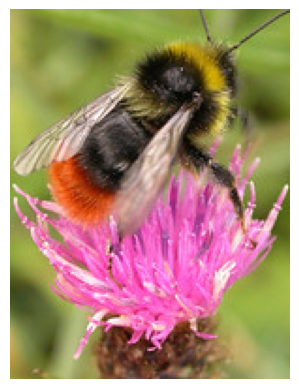

0: 480x640 1 bird, 91.6ms
Speed: 2.1ms preprocess, 91.6ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.8187822699546814


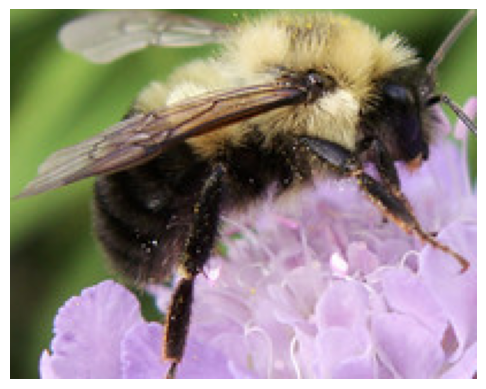

0: 448x640 (no detections), 100.9ms
Speed: 1.0ms preprocess, 100.9ms inference, 0.1ms postprocess per image at shape (1, 3, 448, 640)
0: 576x640 1 bird, 84.8ms
Speed: 1.6ms preprocess, 84.8ms inference, 0.1ms postprocess per image at shape (1, 3, 576, 640)
Displaying bee with confidence 0.42962971329689026


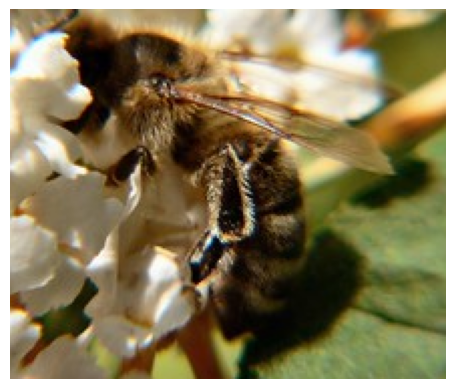

0: 576x640 1 bird, 1 broccoli, 94.0ms
Speed: 1.8ms preprocess, 94.0ms inference, 0.1ms postprocess per image at shape (1, 3, 576, 640)
Displaying bee with confidence 0.3214266896247864


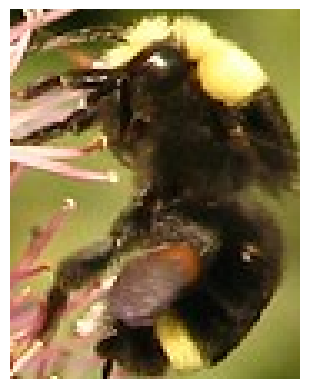

0: 480x640 1 bird, 86.9ms
Speed: 2.1ms preprocess, 86.9ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.43399855494499207


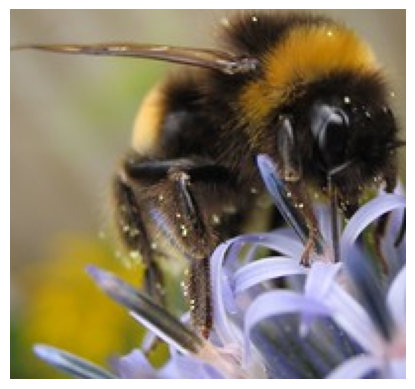

0: 480x640 (no detections), 84.4ms
Speed: 1.1ms preprocess, 84.4ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
0: 480x640 1 bird, 83.5ms
Speed: 1.1ms preprocess, 83.5ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.7747384905815125


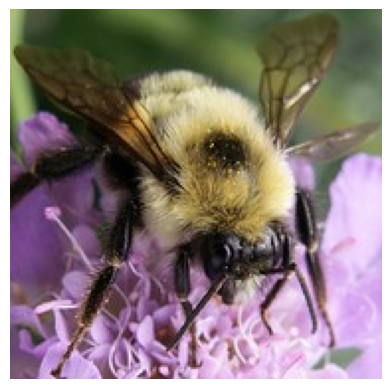

0: 448x640 2 birds, 83.6ms
Speed: 1.1ms preprocess, 83.6ms inference, 0.1ms postprocess per image at shape (1, 3, 448, 640)
Displaying bee with confidence 0.3990638852119446


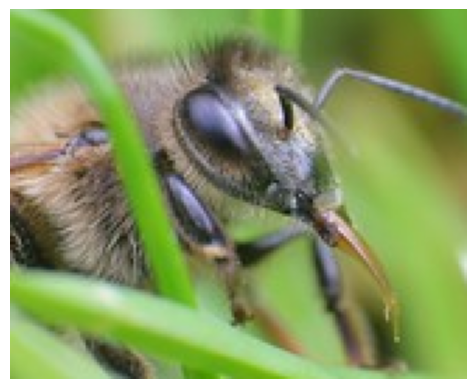

Displaying bee with confidence 0.3204345107078552


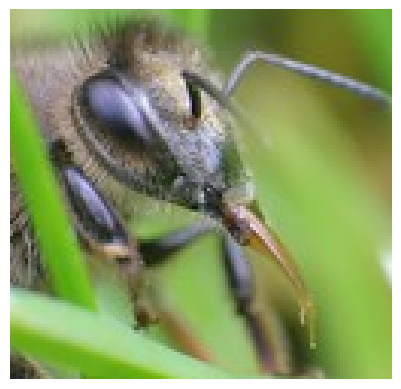

0: 480x640 (no detections), 85.9ms
Speed: 1.2ms preprocess, 85.9ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
0: 448x640 1 bird, 81.6ms
Speed: 1.4ms preprocess, 81.6ms inference, 0.1ms postprocess per image at shape (1, 3, 448, 640)
0: 512x640 2 birds, 79.4ms
Speed: 1.8ms preprocess, 79.4ms inference, 0.1ms postprocess per image at shape (1, 3, 512, 640)
Displaying bee with confidence 0.6600579619407654


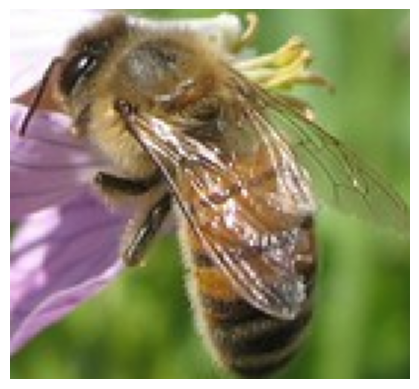

0: 384x640 (no detections), 74.7ms
Speed: 0.8ms preprocess, 74.7ms inference, 0.1ms postprocess per image at shape (1, 3, 384, 640)
0: 512x640 1 bird, 87.0ms
Speed: 1.1ms preprocess, 87.0ms inference, 0.1ms postprocess per image at shape (1, 3, 512, 640)
0: 480x640 2 birds, 68.6ms
Speed: 1.6ms preprocess, 68.6ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.3168093264102936


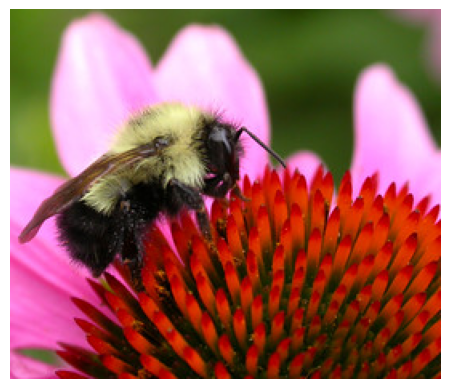

0: 480x640 2 birds, 91.5ms
Speed: 1.1ms preprocess, 91.5ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.8832323551177979


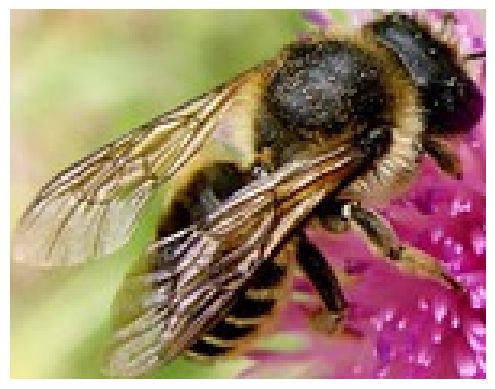

Displaying bee with confidence 0.414724200963974


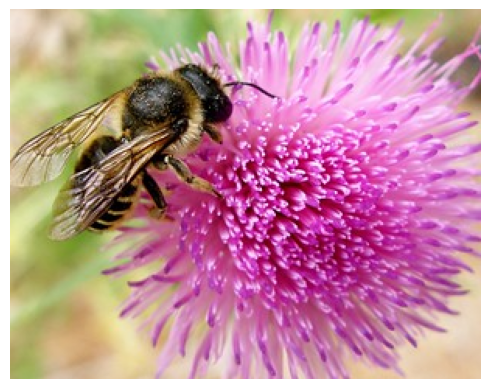

0: 480x640 1 bird, 1 dog, 86.1ms
Speed: 1.0ms preprocess, 86.1ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.34862348437309265


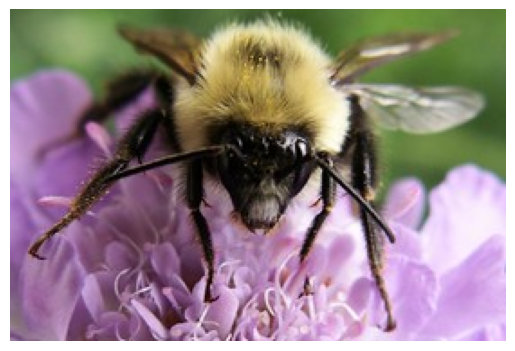

0: 480x640 1 dog, 84.3ms
Speed: 1.2ms preprocess, 84.3ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
0: 480x640 1 banana, 72.2ms
Speed: 1.3ms preprocess, 72.2ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
0: 480x640 1 bird, 66.3ms
Speed: 1.1ms preprocess, 66.3ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.3240533471107483


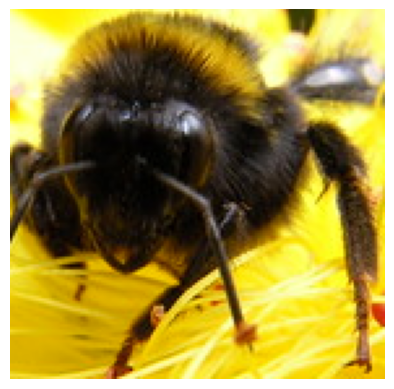

0: 480x640 (no detections), 83.3ms
Speed: 1.0ms preprocess, 83.3ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
0: 512x640 1 banana, 87.1ms
Speed: 1.1ms preprocess, 87.1ms inference, 0.1ms postprocess per image at shape (1, 3, 512, 640)
0: 448x640 1 cat, 59.7ms
Speed: 1.1ms preprocess, 59.7ms inference, 0.1ms postprocess per image at shape (1, 3, 448, 640)
0: 608x640 1 bird, 79.7ms
Speed: 1.4ms preprocess, 79.7ms inference, 0.1ms postprocess per image at shape (1, 3, 608, 640)
Displaying bee with confidence 0.539169192314148


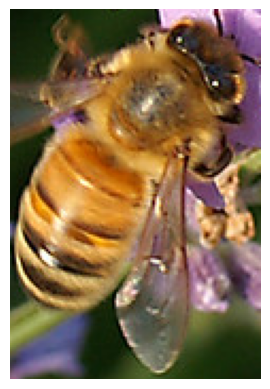

0: 576x640 (no detections), 91.4ms
Speed: 1.3ms preprocess, 91.4ms inference, 0.2ms postprocess per image at shape (1, 3, 576, 640)
0: 480x640 (no detections), 79.4ms
Speed: 1.1ms preprocess, 79.4ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
0: 480x640 1 bird, 68.7ms
Speed: 1.1ms preprocess, 68.7ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.5607427358627319


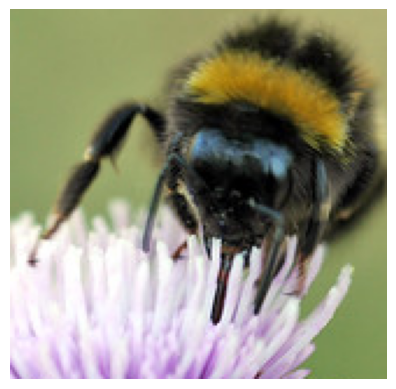

0: 480x640 (no detections), 78.6ms
Speed: 1.0ms preprocess, 78.6ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
0: 512x640 1 bird, 87.1ms
Speed: 1.5ms preprocess, 87.1ms inference, 0.1ms postprocess per image at shape (1, 3, 512, 640)
Displaying bee with confidence 0.8660038113594055


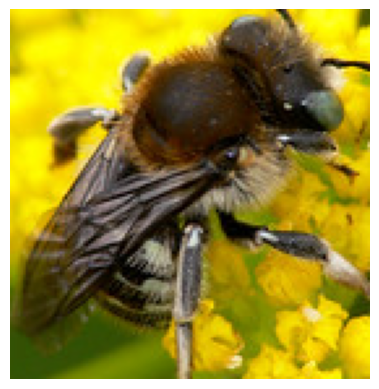

0: 480x640 1 bird, 85.1ms
Speed: 1.0ms preprocess, 85.1ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.5354913473129272


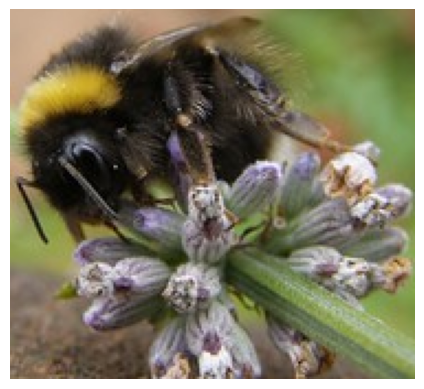

0: 480x640 1 bird, 87.5ms
Speed: 1.0ms preprocess, 87.5ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.48474571108818054


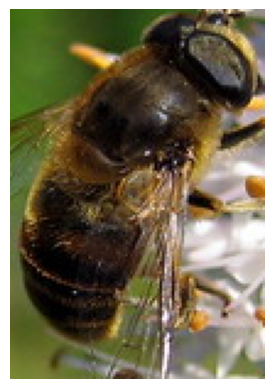

0: 512x640 1 bird, 1 dog, 87.1ms
Speed: 1.4ms preprocess, 87.1ms inference, 0.2ms postprocess per image at shape (1, 3, 512, 640)
Displaying bee with confidence 0.30095770955085754


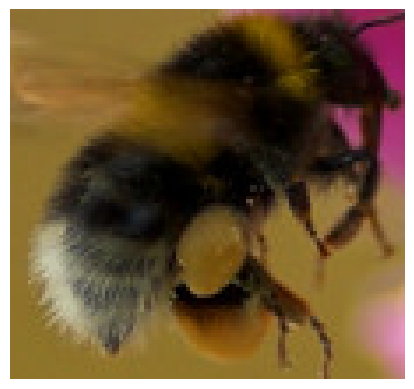

0: 544x640 1 bird, 86.5ms
Speed: 1.5ms preprocess, 86.5ms inference, 0.1ms postprocess per image at shape (1, 3, 544, 640)
Displaying bee with confidence 0.6878080368041992


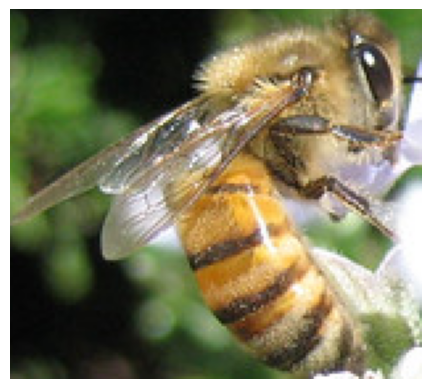

0: 480x640 (no detections), 77.1ms
Speed: 1.0ms preprocess, 77.1ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
0: 480x640 1 bird, 77.3ms
Speed: 1.3ms preprocess, 77.3ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.6285629868507385


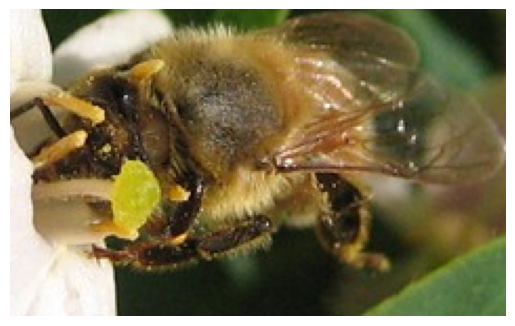

0: 480x640 1 bird, 85.5ms
Speed: 1.1ms preprocess, 85.5ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.33786314725875854


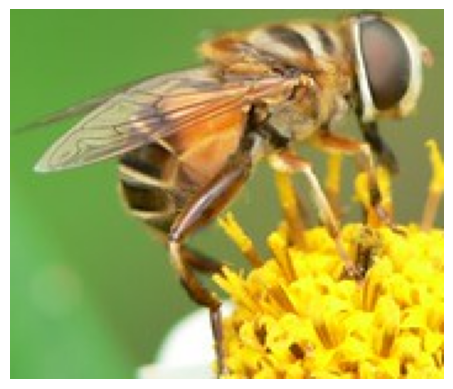

0: 480x640 1 bird, 76.0ms
Speed: 1.1ms preprocess, 76.0ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.5075772404670715


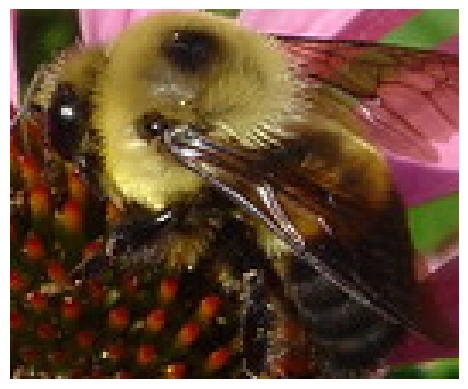

0: 544x640 1 bird, 83.3ms
Speed: 1.7ms preprocess, 83.3ms inference, 0.1ms postprocess per image at shape (1, 3, 544, 640)
Displaying bee with confidence 0.319614440202713


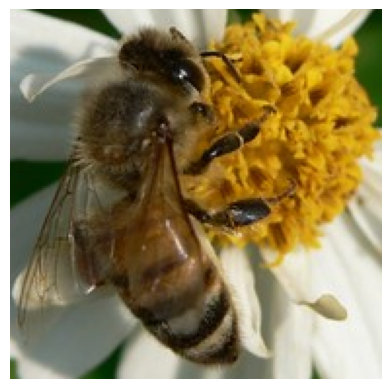

0: 512x640 (no detections), 99.3ms
Speed: 1.5ms preprocess, 99.3ms inference, 0.1ms postprocess per image at shape (1, 3, 512, 640)
0: 480x640 1 person, 1 bird, 63.2ms
Speed: 1.4ms preprocess, 63.2ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.5562784075737


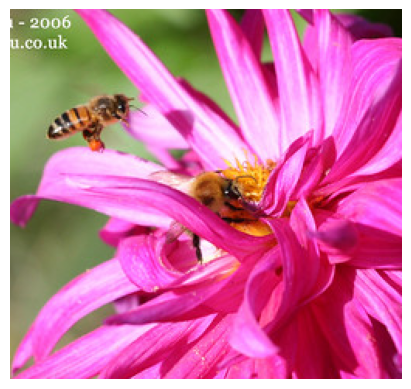

0: 480x640 1 bird, 82.8ms
Speed: 1.2ms preprocess, 82.8ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.8387582302093506


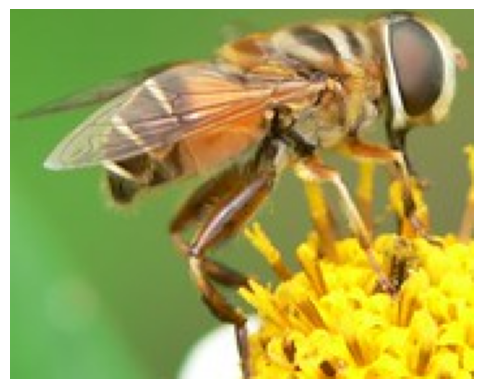

0: 512x640 1 bird, 114.2ms
Speed: 1.1ms preprocess, 114.2ms inference, 0.1ms postprocess per image at shape (1, 3, 512, 640)
Displaying bee with confidence 0.5961837768554688


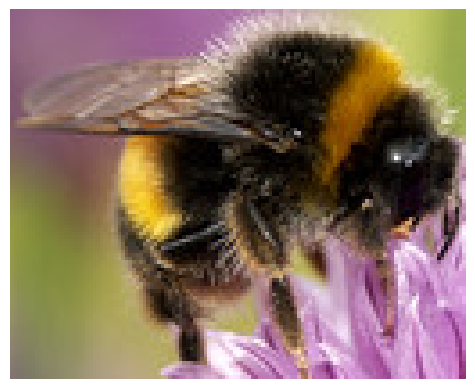

0: 480x640 1 bird, 107.8ms
Speed: 2.2ms preprocess, 107.8ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
0: 448x640 1 bird, 133.3ms
Speed: 1.0ms preprocess, 133.3ms inference, 0.1ms postprocess per image at shape (1, 3, 448, 640)
Displaying bee with confidence 0.5087802410125732


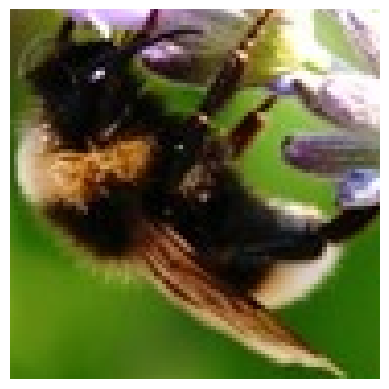

0: 448x640 1 bird, 88.5ms
Speed: 1.0ms preprocess, 88.5ms inference, 0.1ms postprocess per image at shape (1, 3, 448, 640)
Displaying bee with confidence 0.3951522409915924


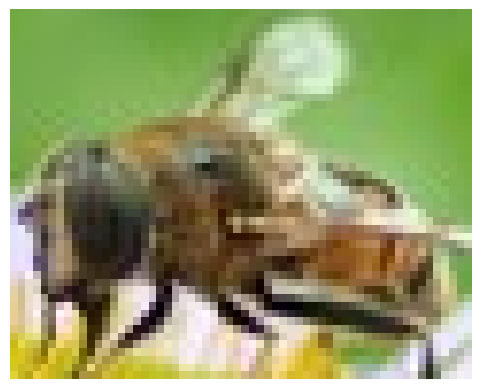

0: 608x640 (no detections), 99.1ms
Speed: 1.8ms preprocess, 99.1ms inference, 0.1ms postprocess per image at shape (1, 3, 608, 640)
0: 544x640 (no detections), 84.3ms
Speed: 1.8ms preprocess, 84.3ms inference, 0.1ms postprocess per image at shape (1, 3, 544, 640)
0: 480x640 (no detections), 66.8ms
Speed: 1.8ms preprocess, 66.8ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
0: 576x640 1 bird, 73.0ms
Speed: 2.1ms preprocess, 73.0ms inference, 0.1ms postprocess per image at shape (1, 3, 576, 640)
Displaying bee with confidence 0.5172845125198364


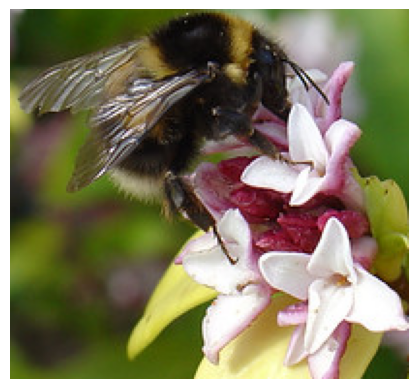

0: 512x640 1 bird, 92.7ms
Speed: 1.0ms preprocess, 92.7ms inference, 0.1ms postprocess per image at shape (1, 3, 512, 640)
Displaying bee with confidence 0.5895941853523254


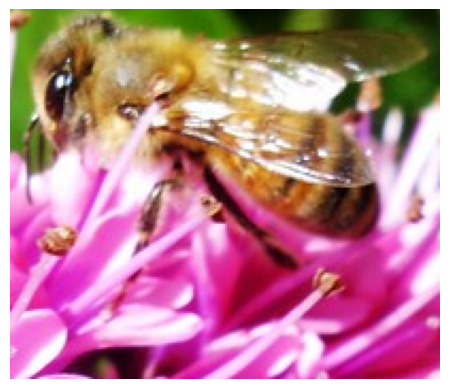

0: 512x640 (no detections), 90.6ms
Speed: 1.2ms preprocess, 90.6ms inference, 0.1ms postprocess per image at shape (1, 3, 512, 640)
0: 640x544 1 bird, 78.2ms
Speed: 1.4ms preprocess, 78.2ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 544)
Displaying bee with confidence 0.7336310744285583


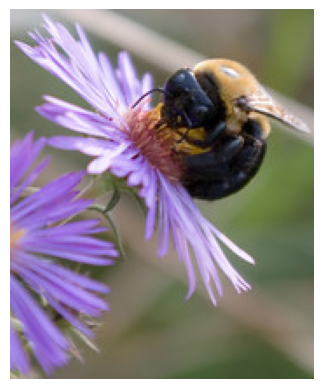

0: 480x640 2 birds, 84.1ms
Speed: 1.2ms preprocess, 84.1ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.6827459335327148


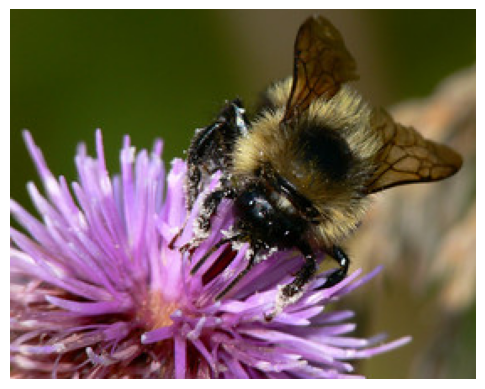

Displaying bee with confidence 0.5615159273147583


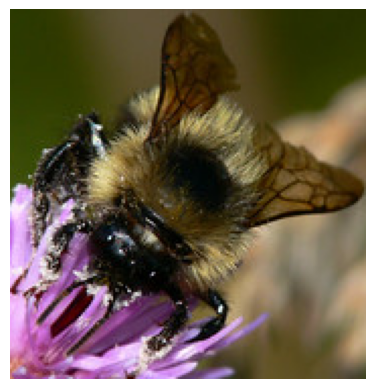

0: 608x640 (no detections), 98.3ms
Speed: 1.8ms preprocess, 98.3ms inference, 0.1ms postprocess per image at shape (1, 3, 608, 640)
0: 480x640 1 cat, 74.6ms
Speed: 1.8ms preprocess, 74.6ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
0: 448x640 1 bird, 67.5ms
Speed: 1.2ms preprocess, 67.5ms inference, 0.1ms postprocess per image at shape (1, 3, 448, 640)
Displaying bee with confidence 0.7205283045768738


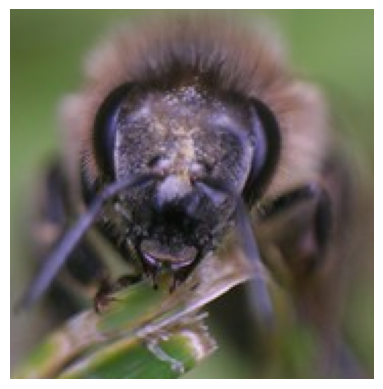

0: 448x640 (no detections), 72.4ms
Speed: 1.2ms preprocess, 72.4ms inference, 0.1ms postprocess per image at shape (1, 3, 448, 640)
0: 576x640 1 cat, 88.3ms
Speed: 2.5ms preprocess, 88.3ms inference, 0.1ms postprocess per image at shape (1, 3, 576, 640)
0: 480x640 (no detections), 61.5ms
Speed: 1.4ms preprocess, 61.5ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
0: 480x640 1 broccoli, 58.8ms
Speed: 1.2ms preprocess, 58.8ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
0: 512x640 (no detections), 72.4ms
Speed: 1.2ms preprocess, 72.4ms inference, 0.1ms postprocess per image at shape (1, 3, 512, 640)
0: 640x512 1 bird, 71.8ms
Speed: 1.0ms preprocess, 71.8ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 512)
Displaying bee with confidence 0.41571637988090515


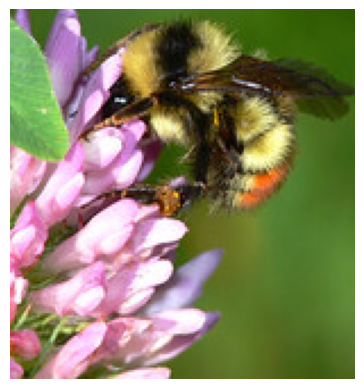

0: 512x640 1 bird, 81.1ms
Speed: 1.1ms preprocess, 81.1ms inference, 0.1ms postprocess per image at shape (1, 3, 512, 640)
Displaying bee with confidence 0.46025046706199646


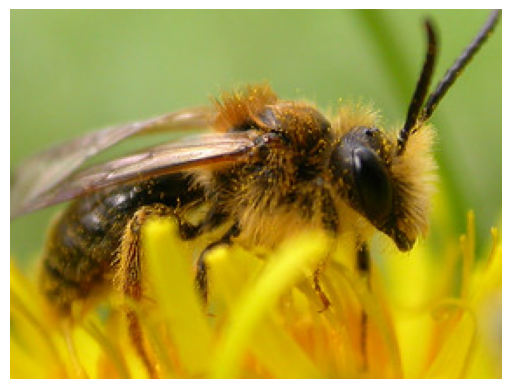

0: 480x640 1 cat, 1 banana, 86.2ms
Speed: 1.2ms preprocess, 86.2ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
0: 480x640 (no detections), 66.5ms
Speed: 1.1ms preprocess, 66.5ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
0: 640x640 (no detections), 84.3ms
Speed: 2.2ms preprocess, 84.3ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 640)
0: 640x576 1 bird, 73.3ms
Speed: 2.1ms preprocess, 73.3ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 576)
Displaying bee with confidence 0.33638080954551697


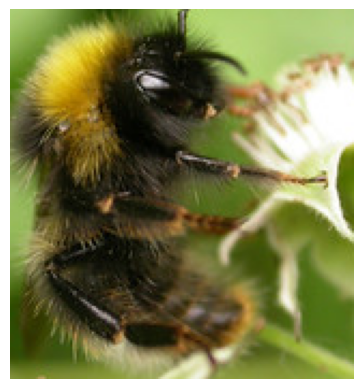

0: 480x640 (no detections), 77.7ms
Speed: 1.3ms preprocess, 77.7ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
0: 640x480 (no detections), 81.7ms
Speed: 1.2ms preprocess, 81.7ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 480)
0: 448x640 1 cat, 59.5ms
Speed: 1.1ms preprocess, 59.5ms inference, 0.1ms postprocess per image at shape (1, 3, 448, 640)
0: 448x640 (no detections), 54.9ms
Speed: 1.1ms preprocess, 54.9ms inference, 0.1ms postprocess per image at shape (1, 3, 448, 640)
0: 640x640 (no detections), 76.8ms
Speed: 1.1ms preprocess, 76.8ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 640)
0: 480x640 1 banana, 1 orange, 66.4ms
Speed: 1.4ms preprocess, 66.4ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
0: 640x640 1 bird, 1 carrot, 81.3ms
Speed: 1.2ms preprocess, 81.3ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 640)
Displaying bee with confidence 0.4389100670814514


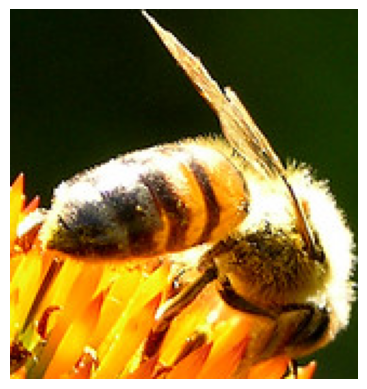

0: 480x640 2 birds, 89.4ms
Speed: 1.1ms preprocess, 89.4ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.5113282799720764


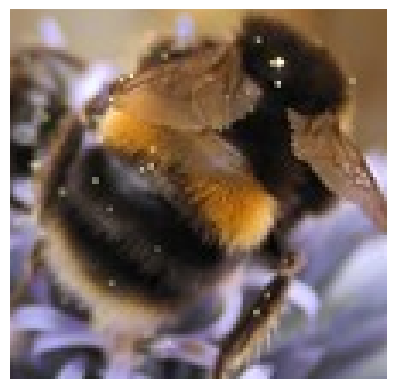

Displaying bee with confidence 0.36583152413368225


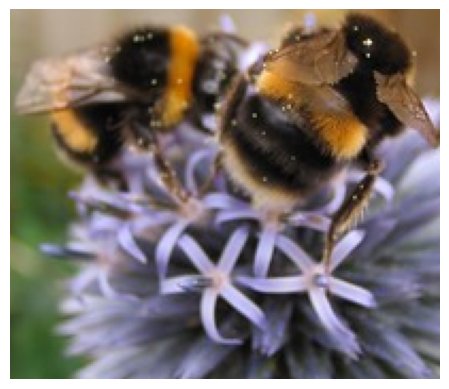

0: 480x640 1 bird, 82.3ms
Speed: 1.6ms preprocess, 82.3ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.8331658840179443


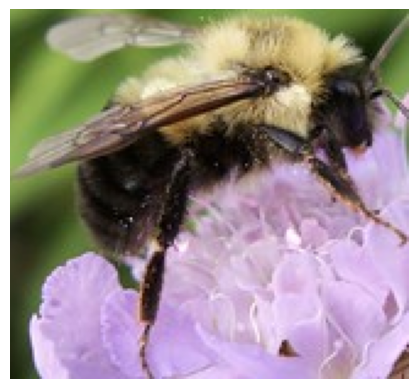

0: 480x640 (no detections), 83.8ms
Speed: 2.5ms preprocess, 83.8ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
0: 480x640 1 cake, 75.0ms
Speed: 1.1ms preprocess, 75.0ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
0: 640x640 1 bird, 78.5ms
Speed: 1.5ms preprocess, 78.5ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 640)
Displaying bee with confidence 0.6587727665901184


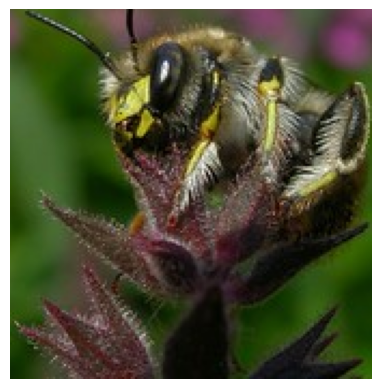

0: 448x640 2 bananas, 73.2ms
Speed: 1.2ms preprocess, 73.2ms inference, 0.1ms postprocess per image at shape (1, 3, 448, 640)
0: 480x640 1 bird, 75.5ms
Speed: 1.4ms preprocess, 75.5ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.6652427911758423


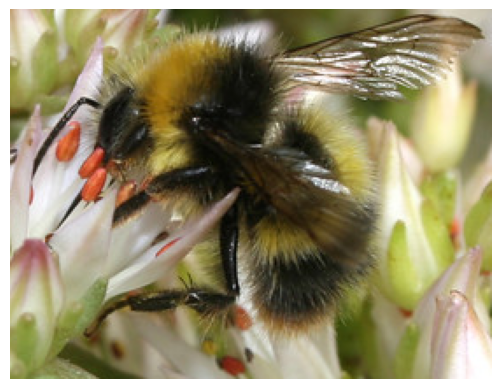

0: 480x640 1 bird, 80.6ms
Speed: 1.0ms preprocess, 80.6ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.8685933351516724


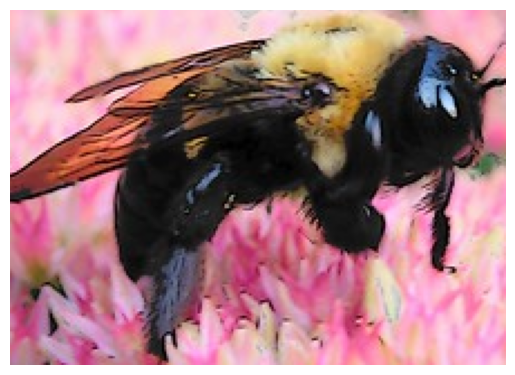

0: 544x640 1 bird, 85.2ms
Speed: 1.2ms preprocess, 85.2ms inference, 0.1ms postprocess per image at shape (1, 3, 544, 640)
Displaying bee with confidence 0.7665485739707947


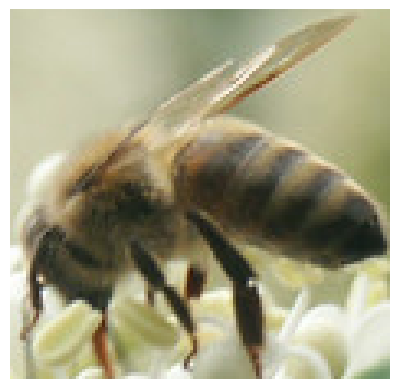

0: 480x640 1 cat, 86.1ms
Speed: 1.2ms preprocess, 86.1ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
0: 448x640 2 birds, 74.4ms
Speed: 1.4ms preprocess, 74.4ms inference, 0.1ms postprocess per image at shape (1, 3, 448, 640)
Displaying bee with confidence 0.48109692335128784


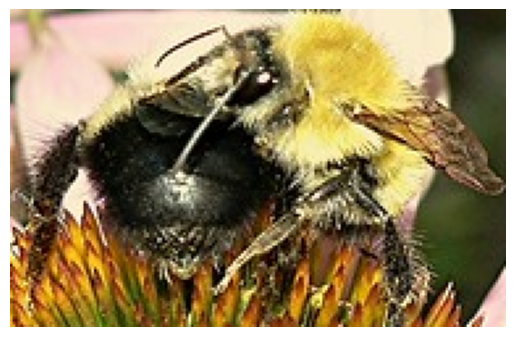

0: 608x640 (no detections), 101.6ms
Speed: 1.7ms preprocess, 101.6ms inference, 0.1ms postprocess per image at shape (1, 3, 608, 640)
0: 480x640 1 bird, 74.0ms
Speed: 2.7ms preprocess, 74.0ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.43010997772216797


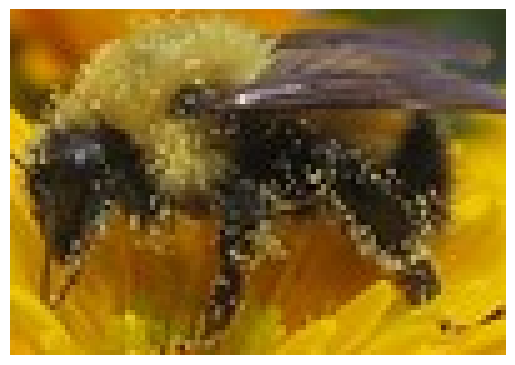

0: 640x480 (no detections), 94.2ms
Speed: 1.3ms preprocess, 94.2ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 480)
0: 448x640 1 bird, 73.0ms
Speed: 1.5ms preprocess, 73.0ms inference, 0.1ms postprocess per image at shape (1, 3, 448, 640)
0: 544x640 1 bird, 78.0ms
Speed: 2.0ms preprocess, 78.0ms inference, 0.1ms postprocess per image at shape (1, 3, 544, 640)
Displaying bee with confidence 0.8240464925765991


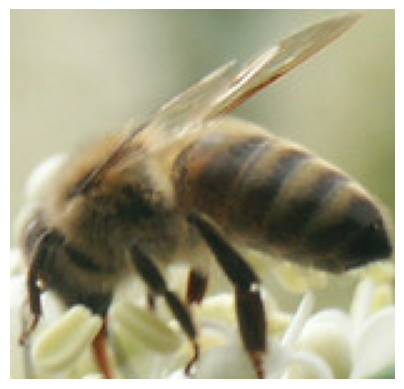

0: 480x640 1 bird, 77.2ms
Speed: 1.2ms preprocess, 77.2ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.5363689064979553


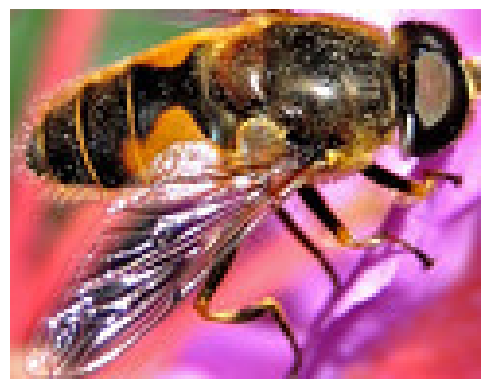

0: 480x640 1 bird, 89.7ms
Speed: 1.0ms preprocess, 89.7ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.7005414366722107


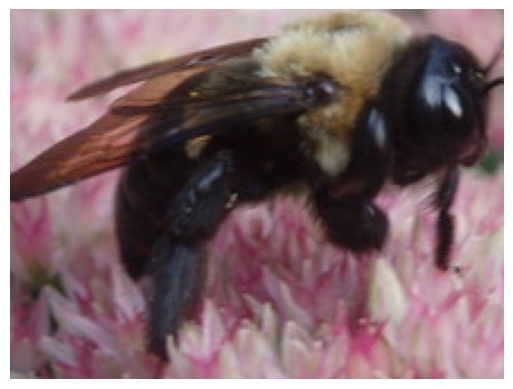

0: 480x640 1 bird, 79.6ms
Speed: 1.3ms preprocess, 79.6ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.6167516112327576


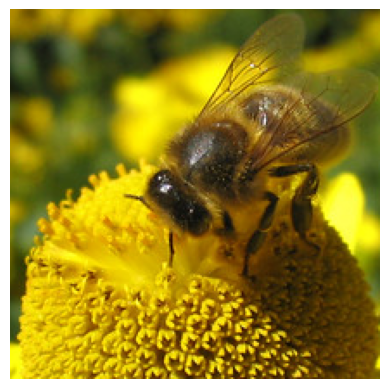

0: 608x640 1 bird, 1 cat, 109.5ms
Speed: 1.9ms preprocess, 109.5ms inference, 0.1ms postprocess per image at shape (1, 3, 608, 640)
Displaying bee with confidence 0.3817860782146454


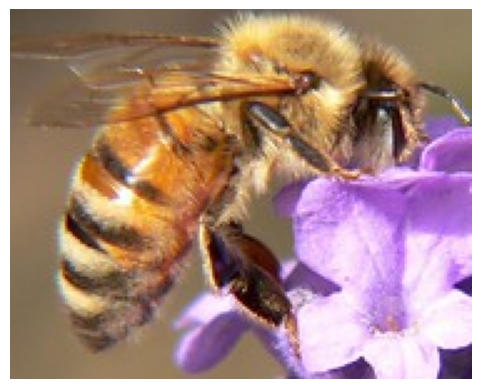

0: 608x640 1 cake, 93.3ms
Speed: 1.3ms preprocess, 93.3ms inference, 0.1ms postprocess per image at shape (1, 3, 608, 640)
0: 512x640 (no detections), 72.5ms
Speed: 1.9ms preprocess, 72.5ms inference, 0.1ms postprocess per image at shape (1, 3, 512, 640)
0: 640x448 (no detections), 64.7ms
Speed: 2.2ms preprocess, 64.7ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 448)
0: 480x640 (no detections), 66.1ms
Speed: 1.4ms preprocess, 66.1ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
0: 640x640 1 bird, 76.3ms
Speed: 1.7ms preprocess, 76.3ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 640)
Displaying bee with confidence 0.3396356999874115


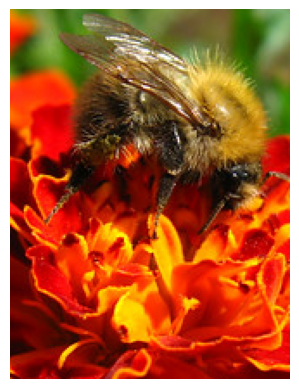

0: 608x640 1 bird, 97.8ms
Speed: 1.3ms preprocess, 97.8ms inference, 0.2ms postprocess per image at shape (1, 3, 608, 640)
Displaying bee with confidence 0.8334740400314331


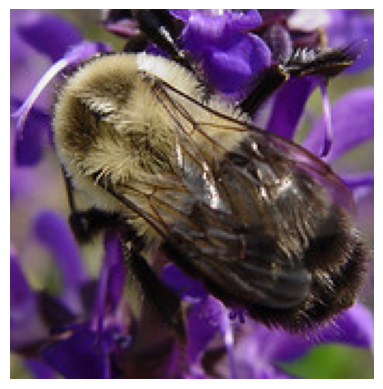

0: 640x480 (no detections), 75.9ms
Speed: 1.0ms preprocess, 75.9ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 480)
0: 608x640 1 cat, 89.6ms
Speed: 1.7ms preprocess, 89.6ms inference, 0.1ms postprocess per image at shape (1, 3, 608, 640)
0: 480x640 (no detections), 66.9ms
Speed: 1.1ms preprocess, 66.9ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
0: 640x640 (no detections), 77.3ms
Speed: 1.3ms preprocess, 77.3ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 640)
0: 640x640 2 birds, 75.3ms
Speed: 1.3ms preprocess, 75.3ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 640)
Displaying bee with confidence 0.33257773518562317


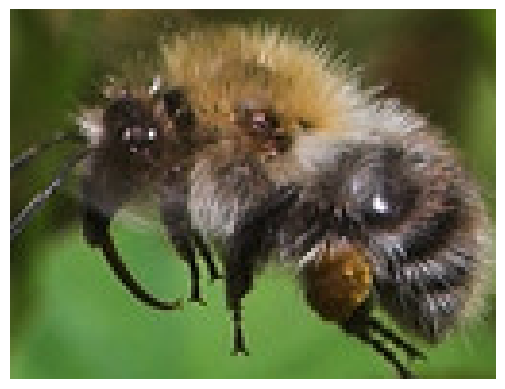

0: 480x640 1 bird, 80.5ms
Speed: 1.2ms preprocess, 80.5ms inference, 0.1ms postprocess per image at shape (1, 3, 480, 640)
Displaying bee with confidence 0.44012370705604553


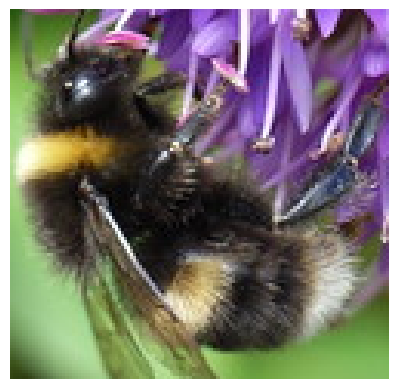

In [7]:
import cv2
import os
from ultralytics import YOLO
from matplotlib import pyplot as plt


model = YOLO('yolov10n.pt') 

images_dir = '/Users/jaeseok/Downloads/hw4_ai4c/kaggle_bee_vs_wasp/bee_temp'


def display_bbox(image, bbox):
    x1, y1, x2, y2 = bbox
    cropped_img = image[int(y1):int(y2), int(x1):int(x2)]
    plt.imshow(cv2.cvtColor(cropped_img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()


for image_file in os.listdir(images_dir):
    image_path = os.path.join(images_dir, image_file)
    if image_file.endswith(('.jpg', '.png', '.jpeg')) and os.path.isfile(image_path):
        # Load image
        image = cv2.imread(image_path)

        # Run YOLO inference on the imagge
        results = model.predict(image)

        # Loop through detections and display only those with label 'bee'
        for result in results[0].boxes.data.tolist():
            x1, y1, x2, y2, confidence, class_id = result
            
            # Assuming 'bee' class has been correctly mapped in training
            if confidence > 0.3 and class_id == 14:
                print(f"Displaying bee with confidence {confidence}")
                display_bbox(image, (x1, y1, x2, y2))
    else:
        print(f"Image file {image_file} not found or not an image file in {images_dir}")


In [15]:
import cv2
import os
import csv
from ultralytics import YOLO



model = YOLO('yolov10n.pt')

images_dir = '/Users/jaeseok/Downloads/hw4_ai4c/kaggle_bee_vs_wasp/wasp2'
output_csv = '/Users/jaeseok/Downloads/hw4_ai4c/kaggle_bee_vs_wasp/wasp2/wasp2_detections.csv'

# Function to display the bounding box crop
def display_bbox(image, bbox):
    x1, y1, x2, y2 = bbox
    cropped_img = image[int(y1):int(y2), int(x1):int(x2)]
    plt.imshow(cv2.cvtColor(cropped_img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

with open(output_csv, mode='w', newline='') as file:
    writer = csv.writer(file)

    writer.writerow(['Filename', 'x1', 'y1', 'x2', 'y2', 'Confidence', 'Class_ID'])
    

    for image_file in os.listdir(images_dir):
        image_path = os.path.join(images_dir, image_file)
        if image_file.endswith(('.jpg', '.png', '.jpeg')) and os.path.isfile(image_path):
            # Load image
            image = cv2.imread(image_path)

            # Run YOLO inference on the image
            results = model.predict(image)


            for result in results[0].boxes.data.tolist():
                x1, y1, x2, y2, confidence, class_id = result


                if confidence > 0.3 and class_id == 14:  # Yolo bird class is 14
                    writer.writerow([image_file, x1, y1, x2, y2, confidence, class_id])
                    
                    # print(f"Displaying bee (classified as bird) with confidence {confidence}")
                    # display_bbox(image, (x1, y1, x2, y2))
                    
        else:
            print(f"Image file {image_file} not found or not an image file in {images_dir}")

print(f"Detections saved to {output_csv}")



0: 640x640 (no detections), 89.6ms
Speed: 1.3ms preprocess, 89.6ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 85.7ms
Speed: 0.8ms preprocess, 85.7ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 77.1ms
Speed: 1.0ms preprocess, 77.1ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 vases, 79.4ms
Speed: 0.9ms preprocess, 79.4ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 76.9ms
Speed: 1.2ms preprocess, 76.9ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 bird, 86.5ms
Speed: 0.8ms preprocess, 86.5ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 77.3ms
Speed: 0.9ms preprocess, 77.3ms inference, 0.1ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 79.2ms
Speed: 1.0ms preprocess, 79.2ms inference, 0.1ms p